# MA5852 A3: Project Proposal
By Anthony Lighterness

## Notebook Outline
1. [Introduction](#1.-Introduction)<br>
2. [Environment Setup](#2.-Environment-Setup)<br>
3. [Data Import](#3.-Data-Import)<br>
4. [Pre-Processing & EDA](#4.-Pre-Processing-&-EDA)<br>
5. [Data Split](#5.-Data-Split)<br>
6. [CNN Base Model](#6.-CNN-Base-Model)<br>
    6.1 [Build](#6.1-Build)<br>
    6.2 [Train](#6.2-Train)<br>
    6.3 [Deploy](#6.3-Deploy)<br>
    6.4 [Evaluate](#6.4-Evaluate)<br>
7. [ResNet50 Transfer Learning](#7.-ResNet50-Transfer-Learning)<br>
8. [Model Comparison](#8.-Model-Compare)<br>


## 1. Introduction
The current project...

## 2. Environment Setup

### 2.1 Libraries and Packages

In [3]:
import sagemaker

import keras
from keras import backend as K
from keras import regularizers, optimizers
from keras.preprocessing import image
from keras_preprocessing.image import ImageDataGenerator
from keras.layers import (Dense, Activation, Flatten, Dropout, 
                          BatchNormalization, Conv2D, MaxPooling2D, 
                          GlobalAveragePooling2D)
from keras.models import Sequential, load_model, Model
from keras.applications import ResNet50
from keras.utils.vis_utils import plot_model

from sklearn.metrics import confusion_matrix, roc_curve, classification_report
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelBinarizer

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten, AveragePooling2D, Dropout
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import boto3
import io

import pandas as pd
import numpy as np
import seaborn as sns

#from pathlib import Path

import matplotlib
%matplotlib inline
import matplotlib.pyplot as plt

import cv2
from builtins import range, input

from glob import glob

import os
import zipfile

print(f'TensorFlow Version: {tf.__version__}')
print(f'SageMaker Version: {sagemaker.__version__}')


TensorFlow Version: 2.1.3
SageMaker Version: 2.41.0


In [10]:
os.getcwd()

'/home/ec2-user/SageMaker/MA5852_A3'

In [21]:
#import shutil

#shutil.rmtree('CT_2D_data/')

In [4]:

sess = sagemaker.Session()
role = sagemaker.get_execution_role()
bucket = sagemaker.Session().default_bucket()
#prefix = 'CT_2D/'

print(sagemaker.__version__)
print('Bucket:\n{}'.format(bucket))

2.41.0
Bucket:
sagemaker-us-east-2-584548989228


In [3]:
# Make a directory to store the data.
#os.makedirs("3D_CT")


### Download Dataset

In [14]:
# Download CT Data from Github of normal CT scans.
url = "https://github.com/hasibzunair/3D-image-classification-tutorial/releases/download/v0.2/CT-0.zip"
filename = os.path.join(os.getcwd(), "CT-0.zip")
keras.utils.get_file(filename, url)

# Download url of abnormal CT scans.
url = "https://github.com/hasibzunair/3D-image-classification-tutorial/releases/download/v0.2/CT-23.zip"
filename = os.path.join(os.getcwd(), "CT-23.zip")
keras.utils.get_file(filename, url)


1045168128/1045162547 [==============================] - 17s 0us/step


'/home/ec2-user/SageMaker/MA5852_A3/CT-23.zip'

In [15]:

# Make a directory to store the data.
os.makedirs("3D_CT", exist_ok=True)

# Unzip data in the newly created directory.
with zipfile.ZipFile("CT-0.zip", "r") as z_fp:
    z_fp.extractall("./3D_CT/")

with zipfile.ZipFile("CT-23.zip", "r") as z_fp:
    z_fp.extractall("./3D_CT/")


In [7]:
pip install nibabel

     |████████████████████████████████| 3.3 MB 6.2 MB/s eta 0:00:01
Note: you may need to restart the kernel to use updated packages.


In [34]:
# utilities to pre-process images
import nibabel as nib

from scipy import ndimage

def read_nifti_file(filepath):
    """Read and load volume"""
    # Read file
    scan = nib.load(filepath)
    # Get raw data
    scan = scan.get_fdata()
    return scan


def normalize(volume):
    """Normalize the volume"""
    min = -1000
    max = 400
    volume[volume < min] = min
    volume[volume > max] = max
    volume = (volume - min) / (max - min)
    volume = volume.astype("float32")
    return volume


def resize_volume(img):
    """Resize across z-axis"""
    # Set the desired depth
    desired_depth = 64
    desired_width = 128
    desired_height = 128
    # Get current depth
    current_depth = img.shape[-1]
    current_width = img.shape[0]
    current_height = img.shape[1]
    # Compute depth factor
    depth = current_depth / desired_depth
    width = current_width / desired_width
    height = current_height / desired_height
    depth_factor = 1 / depth
    width_factor = 1 / width
    height_factor = 1 / height
    # Rotate
    img = ndimage.rotate(img, 90, reshape=False)
    # Resize across z-axis
    img = ndimage.zoom(img, (width_factor, height_factor, depth_factor), order=1)
    return img


def process_scan(path):
    """Read and resize volume"""
    # Read scan
    volume = read_nifti_file(path)
    # Normalize
    volume = normalize(volume)
    # Resize width, height and depth
    volume = resize_volume(volume)
    return volume

In [35]:
# Folder "CT-0" consist of CT scans having normal lung tissue,
# no CT-signs of viral pneumonia.
normal_scan_paths = [
    os.path.join(os.getcwd(), "3D_CT/CT-0", x)
    for x in os.listdir("3D_CT/CT-0")
]
# Folder "CT-23" consist of CT scans having several ground-glass opacifications,
# involvement of lung parenchyma.
abnormal_scan_paths = [
    os.path.join(os.getcwd(), "3D_CT/CT-23", x)
    for x in os.listdir("3D_CT/CT-23")
]

print("CT scans with normal lung tissue: " + str(len(normal_scan_paths)))
print("CT scans with abnormal lung tissue: " + str(len(abnormal_scan_paths)))

CT scans with normal lung tissue: 100
CT scans with abnormal lung tissue: 100


In [36]:
# Read and process the scans.
# Each scan is resized across height, width, and depth and rescaled.
abnormal_scans_3D = np.array([process_scan(path) for path in abnormal_scan_paths])
normal_scans_3D = np.array([process_scan(path) for path in normal_scan_paths])

# For the CT scans having presence of viral pneumonia
# assign 1, for the normal ones assign 0.
abnormal_labels_3D = np.array([1 for _ in range(len(abnormal_scans_3D))])
normal_labels_3D = np.array([0 for _ in range(len(normal_scans_3D))])


In [38]:

# Split data in the ratio 70:20:10 for training, validation, and hold-out test subsets.
x_train_3D = np.concatenate((abnormal_scans_3D[:70], normal_scans_3D[:70]), axis=0)
y_train_3D = np.concatenate((abnormal_labels_3D[:70], normal_labels_3D[:70]), axis=0)
x_val_3D = np.concatenate((abnormal_scans_3D[70:90], normal_scans_3D[70:90]), axis=0)
y_val_3D = np.concatenate((abnormal_labels_3D[70:90], normal_labels_3D[70:90]), axis=0)
x_test_3D = np.concatenate((abnormal_scans_3D[90:], normal_scans_3D[90:]), axis=0)
y_test_3D = np.concatenate((abnormal_labels_3D[90:], normal_labels_3D[90:]), axis=0)

print(
    "Number of samples in train (%d), validation (%d) and hold-out test (%d) data."
    % (x_train_3D.shape[0], x_val_3D.shape[0], x_test_3D.shape[0])
)

Number of samples in train (140), validation (40) and hold-out test (20) data.


In [39]:
prefix_3D = "CT_3D/"
# Upload to local EC2 instance
#os.makedirs("./local_2DCT", exist_ok=True)
np.savez('./local_3DCT/training', image = x_train_3D, label=y_train_3D)
np.savez('./local_3DCT/val', image=x_val_3D, label=y_val_3D)
np.savez('./local_3DCT/test', image=x_test_3D, label=y_test_3D)

# Upload to S3 Bucket 
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix_3D, 'S3_3DCT/training.npz')) \
                                .upload_file('./local_3DCT/training.npz')
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix_3D, 'S3_3DCT/val.npz')) \
                                .upload_file('./local_3DCT/val.npz')
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix_3D, 'S3_3DCT/test.npz')) \
                                .upload_file('./local_3DCT/test.npz')

#CT_3D/S3_3DCT/training.npz
s3_train_3Data = 's3://{}/{}S3_3DCT/training.npz'.format(bucket, prefix_3D)
s3_val_3Data = 's3://{}/{}S3_3DCT/val.npz'.format(bucket, prefix_3D)
s3_test_3Data = 's3://{}/{}S3_3DCT/test.npz'.format(bucket, prefix_3D)

output_location = 's3://{}/{}output'.format(bucket, prefix_3D)

print('Training data will be uploaded to: {}'.format(s3_train_3Data))
print('Validation data will be uploaded to: {}'.format(s3_val_3Data))
print('Test hold-out data will be uploaded to: {}'.format(s3_test_3Data))

print('Training artifacts will be uploaded to: {}'.format(output_location))


Training data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/training.npz
Validation data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/val.npz
Test hold-out data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/test.npz
Training artifacts will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/output


In [40]:
print("Training Subset:", x_train_3D.shape, y_train_3D.shape, ",", 
      "Validation Subset:", x_val_3D.shape, y_val_3D.shape, ",",
      "Holdout Test Shapes:", x_test_3D.shape, y_test_3D.shape)

Training Subset: (140, 128, 128, 64) (140,) , Validation Subset: (40, 128, 128, 64) (40,) , Holdout Test Shapes: (20, 128, 128, 64) (20,)


In [7]:
# Utility to Download from S3 Bucket 

from s3fs.core import S3FileSystem
s3 = S3FileSystem()
                  #s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/training.npz
s3_train_3Data = 's3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/training.npz'
s3_val_3Data='s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/val.npz'
s3_test_3Data='s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/test.npz'

s3_train_3Dnpz = np.load(s3.open(s3_train_3Data))
s3_val_3Dnpz = np.load(s3.open(s3_val_3Data))
s3_test_3Dnpz = np.load(s3.open(s3_test_3Data))

x_train_3D = s3_train_3Dnpz['image']
y_train_3D = s3_train_3Dnpz['label']

x_val_3D = s3_val_3Dnpz['image']
y_val_3D = s3_val_3Dnpz['label']

x_test_3D = s3_test_3Dnpz['image']
y_test_3D = s3_test_3Dnpz['label']


In [8]:
print(x_train_3D.shape)
print(y_train_3D.shape)
print(x_val_3D.shape)
print(y_val_3D.shape)
print(x_test_3D.shape)
print(y_test_3D.shape)

(140, 128, 128, 64)
(140,)
(40, 128, 128, 64)
(40,)
(20, 128, 128, 64)
(20,)


In [6]:
def preprocess(volume, label):
    """Process validation data by only adding a channel."""
    volume = tf.expand_dims(volume, axis=3)
    return volume, label

# Define data loaders.
train_loader_3D = tf.data.Dataset.from_tensor_slices((x_train_3D, y_train_3D))
validation_loader_3D = tf.data.Dataset.from_tensor_slices((x_val_3D, y_val_3D))

train_3Dataset = (
    train_loader_3D.shuffle(len(x_train_3D))
    .map(preprocess)
    .batch(1)
    .prefetch(1)
)
val_3Dataset = (
    validation_loader_3D.shuffle(len(x_val_3D))
    .map(preprocess)
    .batch(1)
    .prefetch(1)
)

In [8]:
train_3Dataset

<PrefetchDataset shapes: ((None, 128, 128, 64, 1), (None,)), types: (tf.float32, tf.int64)>

In [ ]:
import matplotlib.pyplot as plt

data = train_3Dataset.take(1)
images, labels = list(data)[0]
images = images.numpy()
image = images[0]
print("Dimension of the CT scan is:", image.shape)
plt.imshow(np.squeeze(image[:, :, 30]), cmap="gray")


In [ ]:
def plot_slices(num_rows, num_columns, width, height, data):
    """Plot a montage of 20 CT slices"""
    data = np.rot90(np.array(data))
    data = np.transpose(data)
    data = np.reshape(data, (num_rows, num_columns, width, height))
    rows_data, columns_data = data.shape[0], data.shape[1]
    heights = [slc[0].shape[0] for slc in data]
    widths = [slc.shape[1] for slc in data[0]]
    fig_width = 12.0
    fig_height = fig_width * sum(heights) / sum(widths)
    f, axarr = plt.subplots(
        rows_data,
        columns_data,
        figsize=(fig_width, fig_height),
        gridspec_kw={"height_ratios": heights},
    )
    for i in range(rows_data):
        for j in range(columns_data):
            axarr[i, j].imshow(data[i][j], cmap="gray")
            axarr[i, j].axis("off")
    plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1)
    plt.show()


In [ ]:
# Visualize montage of slices.
# 4 rows and 10 columns for 40 slices of the CT scan.
plot_slices(4, 10, 224, 224, image[:, :, :40])


In [ ]:
#3D Training

In [52]:
#Training data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/training.npz
#Validation data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/val.npz
#Test hold-out data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/test.npz
#Training artifacts will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_3D/output
s3_train_3Data = 's3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/training.npz'
s3_val_3Data='s3://sagemaker-us-east-2-584548989228/CT_3D/S3_3DCT/val.npz'


In [ ]:
#CT_3D/S3_3DCT/training.npz
s3_train_3Data = 's3://{}/{}S3_3DCT/training.npz'.format(bucket, prefix_3D)
s3_val_3Data = 's3://{}/{}S3_3DCT/val.npz'.format(bucket, prefix_3D)

output_location = 's3://{}/{}output'.format(bucket, prefix_3D)

print('Training data will be uploaded to: {}'.format(s3_train_3Data))
print('Validation data will be uploaded to: {}'.format(s3_val_3Data))

print('Training artifacts will be uploaded to: {}'.format(output_location))


In [14]:
# train 3D baseline model 
role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

learning_rate = 0.0001
batch_size = 1
epochs = 50

baseline_3D_est = TensorFlow(entry_point='model_3D_baseline.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-baseline')

baseline_3D_est.fit({'training': s3_train_3Data, 'validation': s3_val_3Data})

2021-06-16 09:52:53 Starting - Starting the training job...
2021-06-16 09:53:16 Starting - Launching requested ML instancesProfilerReport-1623837172: InProgress
......
2021-06-16 09:54:16 Starting - Preparing the instances for training.........
2021-06-16 09:55:40 Downloading - Downloading input data......
2021-06-16 09:56:37 Training - Downloading the training image...
2021-06-16 09:57:17 Training - Training image download completed. Training in progress..2021-06-16 09:57:17,590 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-16 09:57:18,101 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hype

In [ ]:
# 3D baseline metrics
#2021-06-16 10:24:15,674 sagemaker-containers INFO     Reporting training SUCCESS

#2021-06-16 10:24:44 Completed - Training job completed
#ProfilerReport-1623837172: IssuesFound
#Training seconds: 1727
#Billable seconds: 1727

#- loss: 0.0014 - accuracy: 1.0000 - precision: 0.8016 - f1_score: 0.7306 - recall: 0.6712 - auc: 1.0000 
#- val_loss: 1.8937 - val_accuracy: 0.6500 - val_precision: 0.8034 - val_f1_score: 0.7327 - val_recall: 0.6735 
# - val_auc: 0.6400
#Model: "ALight3DCNN2"
#_________________________________________________________________
#Layer (type)                 Output Shape              Param #   
#=================================================================
#input_1 (InputLayer)         [(None, 128, 128, 64, 1)] 0         
#_________________________________________________________________
#conv3d (Conv3D)              (None, 126, 126, 62, 64)  1792      
#_________________________________________________________________
#max_pooling3d (MaxPooling3D) (None, 63, 63, 31, 64)    0         
#_________________________________________________________________
#conv3d_1 (Conv3D)            (None, 61, 61, 29, 64)    110656    
#_________________________________________________________________
#max_pooling3d_1 (MaxPooling3 (None, 30, 30, 14, 64)    0         
#_________________________________________________________________
#conv3d_2 (Conv3D)            (None, 28, 28, 12, 128)   221312    
#_________________________________________________________________
#max_pooling3d_2 (MaxPooling3 (None, 14, 14, 6, 128)    0         
#_________________________________________________________________
#conv3d_3 (Conv3D)            (None, 12, 12, 4, 256)    884992    
#_________________________________________________________________
#max_pooling3d_3 (MaxPooling3 (None, 6, 6, 2, 256)      0         
#_________________________________________________________________
#global_average_pooling3d (Gl (None, 256)               0         
#_________________________________________________________________
#dense (Dense)                (None, 512)               131584    
#_________________________________________________________________
#dense_1 (Dense)              (None, 1)                 513       
#=================================================================
#Total params: 1,350,849
#Trainable params: 1,350,849
#Non-trainable params: 0
#Validation Loss    : 1.893664048199409
#Validation Accuracy: 0.65
#Validation F1 Score: 0.80314225
#Validation Precision: 0.7322172
#Validation Recall: 0.6728023
#Validation AUC: 0.64


In [15]:

job_name_3D_base = baseline_3D_est.latest_training_job.name
job_name_3D_base
#'3D-baseline-2021-06-16-09-52-52-626'

'3D-baseline-2021-06-16-09-52-52-626'

In [16]:
# deploy baseline 3D model 
from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

baseline_tf_model_3D = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/3D-baseline-2021-06-16-09-52-52-626/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
baseline_3D_deploy = baseline_tf_model_3D.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
baseline_ep = baseline_3D_deploy.endpoint


update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-------------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


In [7]:
pip install keras_metrics

Note: you may need to restart the kernel to use updated packages.


In [8]:
import keras_metrics as km

# Load Baseline Model
base_model_3D = tf.keras.models.load_model(os.path.join('ALight_3D_CNN_baseline.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})



tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


In [9]:
x_test_3D_exp = x_test_3D.reshape(x_test_3D.shape[0],
                                 x_test_3D.shape[1],
                                 x_test_3D.shape[2],
                                  x_test_3D.shape[3],
                                 1)

In [11]:
print(x_test_3D_exp.shape)
print(y_test_3D.shape)

(20, 128, 128, 64, 1)
(20,)


              precision    recall  f1-score   support

      Normal       0.64      0.90      0.75        10
    Abnormal       0.83      0.50      0.62        10

    accuracy                           0.70        20
   macro avg       0.74      0.70      0.69        20
weighted avg       0.74      0.70      0.69        20



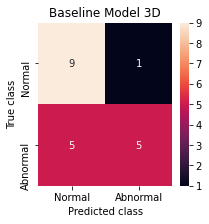

In [14]:
# predictions
base_3D_model_pred_y = base_model_3D.predict(x_test_3D_exp, batch_size=1)
target_names = ["Normal", "Abnormal"]
base_3D_pred_bool = (base_3D_model_pred_y >= 0.5)
base_3D_model_pred_y2 = np.array(base_3D_pred_bool, dtype=int)
print(classification_report(y_test_3D, base_3D_model_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test_3D, y_pred=base_3D_model_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Baseline Model 3D")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [17]:
# train batchnorm job
role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

learning_rate = 0.0001
batch_size = 1
epochs = 50

batchnorm_3D_est = TensorFlow(entry_point='model_3D_batchnorm.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-batchnorm')

batchnorm_3D_est.fit({'training': s3_train_3Data, 'validation': s3_val_3Data})

job_name_3D_batchnorm = batchnorm_3D_est.latest_training_job.name


2021-06-16 10:56:57 Starting - Starting the training job...
2021-06-16 10:56:59 Starting - Launching requested ML instancesProfilerReport-1623841017: InProgress
......
2021-06-16 10:58:20 Starting - Preparing the instances for training.........
2021-06-16 10:59:52 Downloading - Downloading input data......
2021-06-16 11:00:59 Training - Downloading the training image.....2021-06-16 11:01:37,742 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-16 11:01:38,247 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hyperparameters": {
        "model_dir": "s3://sagemaker-us-east-2-584548989228/3D-batchnor

In [18]:
job_name_3D_batchnorm

'3D-batchnorm-2021-06-16-10-56-57-209'

In [ ]:
# 3D batchnorm metrics
#2021-06-16 11:29:54,786 sagemaker-containers INFO     Reporting training SUCCESS

#2021-06-16 11:30:05 Uploading - Uploading generated training model
#2021-06-16 11:30:05 Completed - Training job completed
#Training seconds: 1812
#Billable seconds: 1812


#- loss: 0.6932 - accuracy: 0.4929 - precision: 0.4742 - f1_score: 0.5465 - recall: 0.6448 - auc: 0.4932 
#- val_loss: 0.7218 - val_accuracy: 0.4000 - val_precision: 0.4741 - val_f1_score: 0.5459 - val_recall: 0.6434 
#- val_auc: 0.3550
#Validation Loss    : 0.7217531979084015
#Validation Accuracy: 0.4
#Validation F1 Score: 0.4737234
#Validation Precision: 0.54544353
#Validation Recall: 0.64275444
#Validation AUC: 0.355

In [20]:
from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

# deploy batchnorm 3D model
batchnorm_tf_model_3D = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/3D-batchnorm-2021-06-16-10-56-57-209/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
batchnorm_3D_deploy = batchnorm_tf_model_3D.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
batchnorm_ep = batchnorm_3D_deploy.endpoint

update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-----------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


In [22]:
import keras_metrics as km

# Load Baseline Model
batchnorm_3D_model = tf.keras.models.load_model(os.path.join('ALight_3D_CNN_batchnorm.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})



tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


              precision    recall  f1-score   support

      Normal       0.20      0.10      0.13        10
    Abnormal       0.40      0.60      0.48        10

    accuracy                           0.35        20
   macro avg       0.30      0.35      0.31        20
weighted avg       0.30      0.35      0.31        20



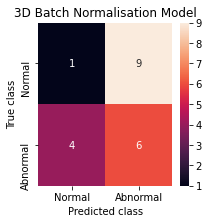

In [23]:
# predictions
BatchNorm_3D_model_pred_y = batchnorm_3D_model.predict(x_test_3D_exp, batch_size=1)
# predictions
target_names = ["Normal", "Abnormal"]
BatchNorm_3D_pred_bool = (BatchNorm_3D_model_pred_y >= 0.5)

BatchNorm_3D_model_pred_y2 = np.array(BatchNorm_3D_pred_bool, dtype=int)

print(classification_report(y_test_3D, BatchNorm_3D_model_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test_3D, y_pred=BatchNorm_3D_model_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("3D Batch Normalisation Model")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [60]:
# train final 3D job
role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

learning_rate = 0.0001
batch_size = 1
epochs = 50

final_3D_est = TensorFlow(entry_point='model_3D_final.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-final')

final_3D_est.fit({'training': s3_train_3Data, 'validation': s3_val_3Data})


2021-06-16 15:09:07 Starting - Starting the training job...
2021-06-16 15:09:30 Starting - Launching requested ML instancesProfilerReport-1623856147: InProgress
......
2021-06-16 15:10:31 Starting - Preparing the instances for training...............
2021-06-16 15:12:51 Downloading - Downloading input data...
2021-06-16 15:13:38 Training - Training image download completed. Training in progress...2021-06-16 15:13:44,639 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-16 15:13:45,225 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hyperparameters": {
        "model_dir": "s3://sagemaker-us-east-

In [ ]:
#2021-06-16 15:44:14,737 sagemaker-containers INFO     Reporting training SUCCESS

#2021-06-16 15:44:19 Uploading - Uploading generated training model
#2021-06-16 15:44:59 Completed - Training job completed
#ProfilerReport-1623856147: IssuesFound
#Training seconds: 1908
#Billable seconds: 1908

# - loss: 0.6935 - accuracy: 0.5000 - precision: 0.4893 - f1_score: 0.5962 - recall: 0.7628 - auc: 0.4681 
#- val_loss: 0.6944 - val_accuracy: 0.5250 - val_precision: 0.4892 - val_f1_score: 0.5940 - val_recall: 0.7558 
#- val_auc: 0.4688

#Validation Loss    : 0.6943944901227951
#Validation Accuracy: 0.525
#Validation F1 Score: 0.48931512
#Validation Precision: 0.59322715
#Validation Recall: 0.7531737
#Validation AUC: 0.46875

#Model: "ALight3D_FINAL"
#_________________________________________________________________
#Layer (type)                 Output Shape              Param #   
#=================================================================
#input_1 (InputLayer)         [(None, 128, 128, 64, 1)] 0         
#_________________________________________________________________
#conv3d (Conv3D)              (None, 128, 128, 64, 64)  1792      
#_________________________________________________________________
#max_pooling3d (MaxPooling3D) (None, 64, 64, 32, 64)    0         
#_________________________________________________________________
#batch_normalization (BatchNo (None, 64, 64, 32, 64)    256       
#_________________________________________________________________
#conv3d_1 (Conv3D)            (None, 64, 64, 32, 64)    110656    
#_________________________________________________________________
#max_pooling3d_1 (MaxPooling3 (None, 32, 32, 16, 64)    0         
#_________________________________________________________________
#batch_normalization_1 (Batch (None, 32, 32, 16, 64)    256       
#_________________________________________________________________
#conv3d_2 (Conv3D)            (None, 32, 32, 16, 128)   221312    
#_________________________________________________________________
#max_pooling3d_2 (MaxPooling3 (None, 16, 16, 8, 128)    0         
#_________________________________________________________________
#batch_normalization_2 (Batch (None, 16, 16, 8, 128)    512       
#_________________________________________________________________
#conv3d_3 (Conv3D)            (None, 16, 16, 8, 256)    884992    
#_________________________________________________________________
#max_pooling3d_3 (MaxPooling3 (None, 8, 8, 4, 256)      0         
#_________________________________________________________________
#batch_normalization_3 (Batch (None, 8, 8, 4, 256)      1024      
#_________________________________________________________________
#conv3d_4 (Conv3D)            (None, 8, 8, 4, 256)      1769728   
#_________________________________________________________________
#max_pooling3d_4 (MaxPooling3 (None, 4, 4, 2, 256)      0         
#_________________________________________________________________
#batch_normalization_4 (Batch (None, 4, 4, 2, 256)      1024      
#_________________________________________________________________
#conv3d_5 (Conv3D)            (None, 4, 4, 2, 128)      262272    
#_________________________________________________________________
#max_pooling3d_5 (MaxPooling3 (None, 2, 2, 1, 128)      0         
#_________________________________________________________________
#batch_normalization_5 (Batch (None, 2, 2, 1, 128)      512       
#_________________________________________________________________
#global_average_pooling3d (Gl (None, 128)               0         
#_________________________________________________________________
#dense (Dense)                (None, 512)               66048     
#_________________________________________________________________
#dropout (Dropout)            (None, 512)               0         
#_________________________________________________________________
#flatten (Flatten)            (None, 512)               0         
#_________________________________________________________________
#dense_1 (Dense)              (None, 256)               131328    
#_________________________________________________________________
#dense_2 (Dense)              (None, 128)               32896     
#_________________________________________________________________
#dense_3 (Dense)              (None, 64)                8256      
#_________________________________________________________________
#dense_4 (Dense)              (None, 32)                2080      
#_________________________________________________________________
#dense_5 (Dense)              (None, 1)                 33        
#=================================================================
#Total params: 3,494,977
#Trainable params: 3,493,185
#Non-trainable params: 1,792



In [61]:
job_name_3D_final = final_3D_est.latest_training_job.name


In [62]:
job_name_3D_final

'3D-final-2021-06-16-15-09-07-449'

In [63]:
from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

# deploy final 3D model
final_tf_model_3D = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/3D-final-2021-06-16-15-09-07-449/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
final_3D_deploy = final_tf_model_3D.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
final_ep = final_3D_deploy.endpoint

update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-----------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


In [5]:
import tensorflow as tf
import keras_metrics as km

# Load Baseline Model
final_model_3D = tf.keras.models.load_model(os.path.join('ALight_3D_FINAL.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})



tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


              precision    recall  f1-score   support

      Normal       0.53      1.00      0.69        10
    Abnormal       1.00      0.10      0.18        10

    accuracy                           0.55        20
   macro avg       0.76      0.55      0.44        20
weighted avg       0.76      0.55      0.44        20



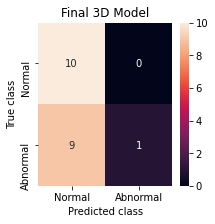

In [10]:
# predictions
final_3D_model_pred_y = final_model_3D.predict(x_test_3D_exp, batch_size=1)
# predictions
target_names = ["Normal", "Abnormal"]
final_3D_pred_bool = (final_3D_model_pred_y >= 0.5)

final_3D_model_pred_y2 = np.array(final_3D_pred_bool, dtype=int)

print(classification_report(y_test_3D, final_3D_model_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test_3D, 
                               y_pred=final_3D_model_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Final 3D Model")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [14]:
from PIL import Image
import s3fs

fs = s3fs.S3FileSystem()

bucket = 'sagemaker-us-east-2-584548989228'
key_normal = 'CT_2D/CT-0-png-m'
key_abnormal = 'CT_2D/CT-23-png-m'
S3_normal = 's3://sagemaker-us-east-2-584548989228/CT_2D/CT-0-png-m'
S3_abnormal = 's3://sagemaker-us-east-2-584548989228/CT_2D/CT-23-png-m'


In [32]:
S3_norm_list = np.array(fs.ls(S3_normal)[:])
S3_abnorm_list = np.array(fs.ls(S3_abnormal)[:])

In [8]:
os.getcwd()
#os.makedirs("./CT_2D_data/")
#os.makedirs("./local_2DCT/normal", exist_ok=True)
#os.makedirs("./local_2DCT/abnormal", exist_ok=True)


'/home/ec2-user/SageMaker/MA5852_A3'

In [44]:
#CT-abnormal-m.zip
# Unzip data in the newly created directory.
with zipfile.ZipFile("./local_2DCT/CT-normal-m.zip", "r") as z_fp:
    z_fp.extractall("./local_2DCT/normal")

with zipfile.ZipFile("./local_2DCT/CT-abnormal-m.zip", "r") as z_fp:
    z_fp.extractall("./local_2DCT/abnormal")

In [125]:
local_abnormal = './local_2DCT/abnormal'
local_normal = './local_2DCT/normal'
abnormal_files = glob(os.path.join(local_abnormal, '*.png'))
normal_files = glob(os.path.join(local_normal, '*.png'))

In [126]:
# Visualize file variable contents
print("First 5 Abnormal Files: ",abnormal_files[0:2])
print("Total Count: ",len(abnormal_files))
print("First 5 Normal Files: ",normal_files[0:2])
print("Total Count: ",len(normal_files))

First 5 Abnormal Files:  ['./local_2DCT/abnormal/study_1087_output-slice020.png', './local_2DCT/abnormal/study_0989_output-slice019.png']
Total Count:  100
First 5 Normal Files:  ['./local_2DCT/normal/study_0007_output-slice022.png', './local_2DCT/normal/study_0040_output-slice026.png']
Total Count:  100


In [133]:
# Fetch Images and Class Labels from Files
abnormal_labels = []
normal_labels = []

abnormal_images=[]
normal_images=[]

for i in range(len(abnormal_files)):
    image = cv2.imread(abnormal_files[i]) # read file 
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # arrange format as per keras
    image = cv2.resize(image,(224,224)) # resize as per model
    abnormal_images.append(image) # append image
    abnormal_labels.append('CT_abnormal') #append class label

for i in range(len(normal_files)):
    image = cv2.imread(normal_files[i])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image,(224,224))
    normal_images.append(image)
    normal_labels.append('CT_normal')

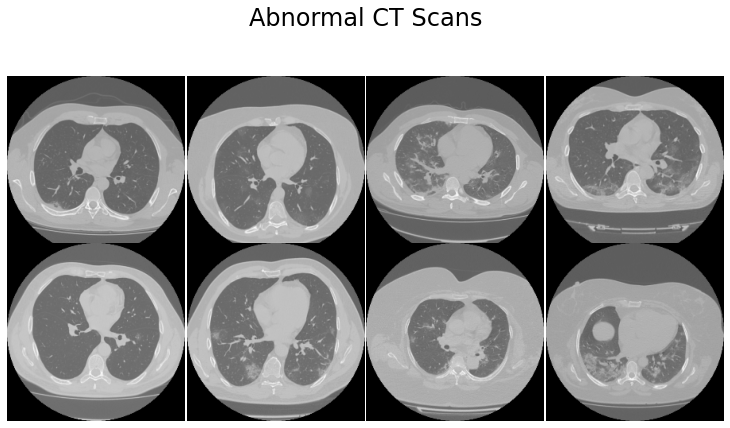

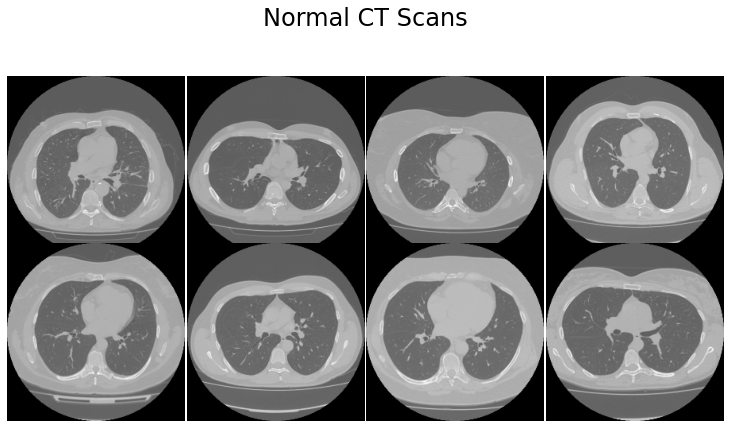

In [128]:
# look at a random image for fun
def plot_images(images, title):
    nrows, ncols = 2, 4
    figsize = [10, 6]

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, 
                           figsize=figsize, facecolor=(1, 1, 1))

    for i, axi in enumerate(ax.flat):
        axi.imshow(images[i])
        axi.set_axis_off()

    plt.suptitle(title, fontsize=24)
    plt.tight_layout(pad=0.2, rect=[0, 0, 1, 0.9])
    plt.show()
plot_images(abnormal_images, 'Abnormal CT Scans')
plot_images(normal_images, 'Normal CT Scans')

In [141]:
normal_img_array = np.array(normal_images)
abnormal_img_array = np.array(abnormal_images)

normal_img_arr_norm = normal_img_array / 255
abnormal_img_arr_norm = abnormal_img_array / 255

# For the CT scans having presence of viral pneumonia
# assign 1, for the normal ones assign 0.
abnormal_labels = np.array([1 for _ in range(len(normal_img_arr_norm))])
normal_labels = np.array([0 for _ in range(len(abnormal_img_arr_norm))])


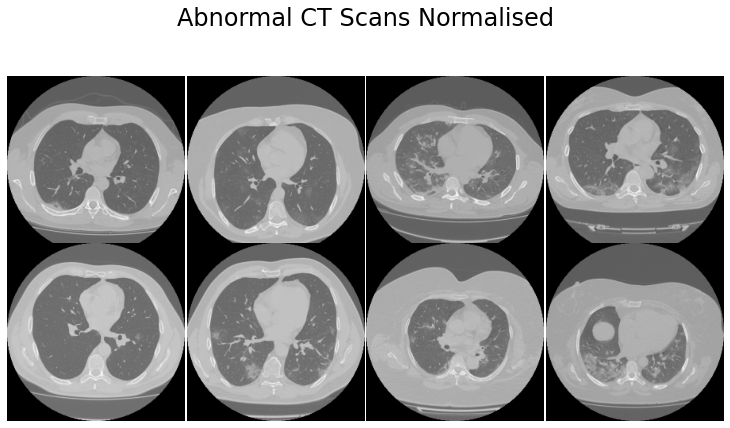

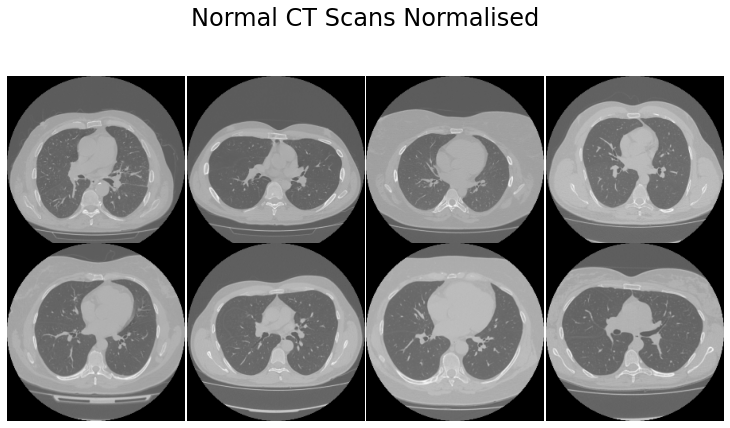

In [143]:
# look at a random image for fun
def plot_images(images, title):
    nrows, ncols = 2, 4
    figsize = [10, 6]

    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, 
                           figsize=figsize, facecolor=(1, 1, 1))

    for i, axi in enumerate(ax.flat):
        axi.imshow(images[i])
        axi.set_axis_off()

    plt.suptitle(title, fontsize=24)
    plt.tight_layout(pad=0.2, rect=[0, 0, 1, 0.9])
    plt.show()
plot_images(abnormal_img_arr_norm, 'Abnormal CT Scans Normalised')
plot_images(normal_img_arr_norm, 'Normal CT Scans Normalised')

In [144]:
#abnormal_img_arr_norm
#normal_labels
# Split Scans Training/Validation/Testing subsets (70:20:10)
x_train = np.concatenate((abnormal_img_arr_norm[:70], normal_img_arr_norm[:70]), axis=0)
y_train = np.concatenate((abnormal_labels[:70], normal_labels[:70]), axis=0)

x_val = np.concatenate((abnormal_img_arr_norm[70:90], normal_img_arr_norm[70:90]), axis=0)
y_val = np.concatenate((abnormal_labels[70:90], normal_labels[70:90]), axis=0)

x_test = np.concatenate((abnormal_img_arr_norm[90:100], normal_img_arr_norm[90:100]),axis=0)
y_test = np.concatenate((abnormal_labels[90:100], normal_labels[90:100]),axis=0)

print("Number of samples in train (%d), validation (%d) and testing (%d)."
    % (x_train.shape[0], x_val.shape[0], x_test.shape[0]))

Number of samples in train (140), validation (40) and testing (20).


In [145]:
print(x_train.dtype)
print(x_train.shape)
print(y_train.shape)
print(x_val.dtype)
print(x_val.shape)
print(y_val.shape)
print(x_test.dtype)
print(x_test.shape)
print(y_test.shape)

float64
(140, 224, 224, 3)
(140,)
float64
(40, 224, 224, 3)
(40,)
float64
(20, 224, 224, 3)
(20,)


In [ ]:
# normalisation
# Convert to array and Normalize to interval of [0,1]
#abnorm_images = np.array(abnormal_images) / 255
#norm_images = np.array(normal_images) / 255

#abnorm_images = x_train.astype('float32')
#norm_images = x_val.astype('float32')


In [146]:
# Upload to local EC2 instance
#os.makedirs("./local_2DCT", exist_ok=True)
np.savez('./local_2DCT/training', image = x_train, label=y_train)
np.savez('./local_2DCT/val', image=x_val, label=y_val)
np.savez('./local_2DCT/test', image=x_test, label=y_test)

# Upload to S3 Bucket 
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix, 'S3_2DCT/training.npz')) \
                                .upload_file('./local_2DCT/training.npz')
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix, 'S3_2DCT/val.npz')) \
                                .upload_file('./local_2DCT/val.npz')
boto3.Session().resource('s3').Bucket(bucket).Object(os.path.join(prefix, 'S3_2DCT/test.npz')) \
                                .upload_file('./local_2DCT/test.npz')

#CT_2D/S3_2DCT/training.npz
s3_train_data = 's3://{}/{}S3_2DCT/training.npz'.format(bucket, prefix)
s3_val_data = 's3://{}/{}S3_2DCT/val.npz'.format(bucket, prefix)
s3_test_data = 's3://{}/{}S3_2DCT/test.npz'.format(bucket, prefix)

output_location = 's3://{}/{}output'.format(bucket, prefix)

print('Training data will be uploaded to: {}'.format(s3_train_data))
print('Validation data will be uploaded to: {}'.format(s3_val_data))
print('Test hold-out data will be uploaded to: {}'.format(s3_test_data))

print('Training artifacts will be uploaded to: {}'.format(output_location))


Training data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/training.npz
Validation data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/val.npz
Test hold-out data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/test.npz
Training artifacts will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/output


In [122]:
# Utility to Download from S3 Bucket 

from s3fs.core import S3FileSystem
s3 = S3FileSystem()

key_train = 'CT_2D/S3_2DCT/training.npz'
key_val = 'CT_2D/S3_2DCT/val.npz'
key_test = 'CT_2D/S3_2DCT/test.npz'

bucket = 'sagemaker-us-east-2-584548989228'
#sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/

s3_train_npz = np.load(s3.open('{}/{}'.format(bucket, key_val)))
s3_val_npz = np.load(s3.open('{}/{}'.format(bucket, key_val)))
s3_test_npz = np.load(s3.open('{}/{}'.format(bucket, key_test)))

x_train = s3_train_npz['image']
y_train = s3_train_npz['label']

x_val = s3_val_npz['image']
y_val = s3_val_npz['label']

x_test = s3_test_npz['image']
y_test = s3_test_npz['label']


In [151]:
print(x_train.dtype)
print(x_train.shape)
print(y_train.shape)
print(x_val.dtype)
print(x_val.shape)
print(y_val.shape)
print(x_test.dtype)
print(x_test.shape)
print(y_test.shape)

float64
(140, 224, 224, 3)
(140,)
float64
(40, 224, 224, 3)
(40,)
float64
(20, 224, 224, 3)
(20,)


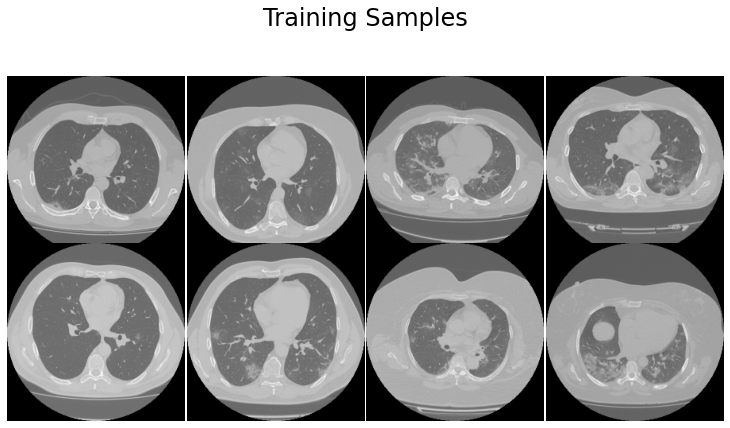

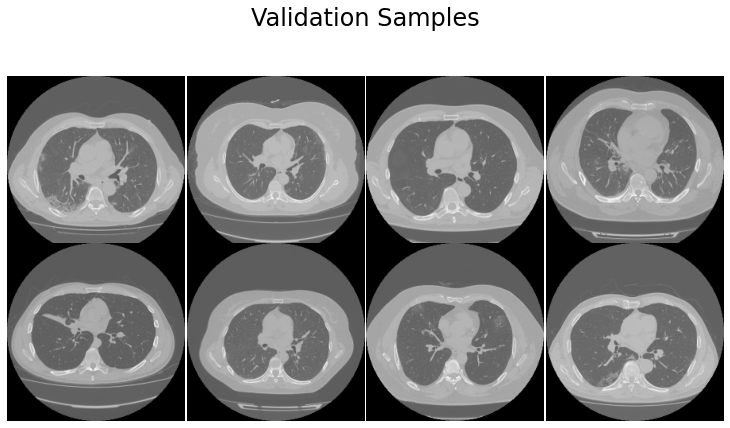

In [148]:
plot_images(x_train, 'Training Samples')
plot_images(x_test, 'Validation Samples')


In [105]:
#CT_2D/S3_2DCT/training.npz
s3_train_data = 's3://{}/{}S3_2DCT/training.npz'.format(bucket, prefix)
s3_val_data = 's3://{}/{}S3_2DCT/val.npz'.format(bucket, prefix)

output_location = 's3://{}/{}output'.format(bucket, prefix)

print('Training data will be uploaded to: {}'.format(s3_train_data))
print('Validation data will be uploaded to: {}'.format(s3_val_data))

print('Training artifacts will be uploaded to: {}'.format(output_location))


Training data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/training.npz
Validation data will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/S3_2DCT/val.npz
Training artifacts will be uploaded to: s3://sagemaker-us-east-2-584548989228/CT_2D/output


In [208]:
# train baseline model 
role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

learning_rate = 0.0001
batch_size = 1
epochs = 50

my_estimator = TensorFlow(entry_point='model_2D_baseline.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='2D-baseline')


In [213]:
my_estimator.fit({'training': s3_train_data, 'validation': s3_val_data})

2021-06-15 16:16:48 Starting - Starting the training job...
2021-06-15 16:16:50 Starting - Launching requested ML instancesProfilerReport-1623773808: InProgress
......
2021-06-15 16:18:14 Starting - Preparing the instances for training.........
2021-06-15 16:19:37 Downloading - Downloading input data
2021-06-15 16:19:37 Training - Downloading the training image.........
2021-06-15 16:21:15 Training - Training image download completed. Training in progress.2021-06-15 16:21:12,850 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-15 16:21:13,291 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hyper

In [ ]:
# Baseline Model
#Model: "ALight3DCNN"
#_________________________________________________________________
#Layer (type)                 Output Shape              Param #   
#=================================================================
#input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
#_________________________________________________________________
#conv2d (Conv2D)              (None, 222, 222, 64)      1792      
#_________________________________________________________________
#max_pooling2d (MaxPooling2D) (None, 111, 111, 64)      0         
#_________________________________________________________________
#conv2d_1 (Conv2D)            (None, 109, 109, 64)      36928     
#_________________________________________________________________
#max_pooling2d_1 (MaxPooling2 (None, 54, 54, 64)        0         
#_________________________________________________________________
#conv2d_2 (Conv2D)            (None, 52, 52, 128)       73856     
#_________________________________________________________________
#max_pooling2d_2 (MaxPooling2 (None, 26, 26, 128)       0         
#_________________________________________________________________
#conv2d_3 (Conv2D)            (None, 24, 24, 256)       295168    
#_________________________________________________________________
#max_pooling2d_3 (MaxPooling2 (None, 12, 12, 256)       0         
#_________________________________________________________________
#global_average_pooling2d (Gl (None, 256)               0         
#_________________________________________________________________
#dense (Dense)                (None, 512)               131584    
#_________________________________________________________________
#dense_1 (Dense)              (None, 1)                 513       
#=================================================================
#Total params: 539,841
#Trainable params: 539,841
#Non-trainable params: 0


#2021-06-15 16:23:20 Uploading - Uploading generated training model
#2021-06-15 16:23:20 Completed - Training job completed
#2021-06-15 16:23:10,105 sagemaker-containers INFO     Reporting training SUCCESS
#Training seconds: 236
#Billable seconds: 236

#- loss: 0.6802 - accuracy: 0.5429 - precision: 0.5037 - f1_score: 0.5120 - recall: 0.5205 - auc: 0.6092 
#- val_loss: 0.6952 - val_accuracy: 0.4000 - val_precision: 0.5035 - val_f1_score: 0.5120 - val_recall: 0.5209 
#- val_auc: 0.4075
#Validation Loss    : 0.6952260881662369
#Validation Accuracy: 0.4
#Validation F1 Score: 0.5030772
#Validation Precision: 0.5115534
#Validation Recall: 0.52032
#Validation AUC: 0.40749997
#Saving model to: /opt/ml/model

In [214]:
# save model artifacts

job_name = my_estimator.latest_training_job.name
job_name
#2D-baseline-2021-06-15-16-16-48-227'

'2D-baseline-2021-06-15-16-16-48-227'

In [ ]:
# Save best model

#best_job = sm.describe_training_job(TrainingJobName=job_name)

best_model_artefact = job_name['ModelArtifacts']['S3ModelArtifacts']
best_model_container = job_name['AlgorithmSpecification']['TrainingImage']

print(job_name)
print(best_model_artefact)
print(best_model_container)

In [260]:

from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

baseline_tf_model = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/2D-baseline-2021-06-15-16-16-48-227/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
baseline_deploy = baseline_tf_model.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
baseline_ep = baseline_deploy.endpoint


update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-----------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


In [250]:
os.getcwd()

'/home/ec2-user/SageMaker/MA5852_A3'

In [268]:
import keras_metrics as km

# Load Baseline Model
base_model = tf.keras.models.load_model(os.path.join('ALight_2D_CNN_baseline.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})



tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


In [274]:
base_model

In [ ]:
# load model to plot performance (accuracy, loss, F1 and AUC) over epochs
fig, ax = plt.subplots(1, 2, figsize=(20, 3))
ax = ax.ravel()

for i, metric in enumerate(["accuracy", "loss"]):
    ax[i].plot(base_model.history.history[metric])
    ax[i].plot(base_model.history.history["val_" + metric])
    ax[i].set_title("Base Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])


fig, ax = plt.subplots(1, 2, figsize=(20, 3))
ax = ax.ravel()

for i, metric in enumerate(["f1_score", "auc_1"]):
    ax[i].plot(base_model.history.history[metric])
    ax[i].plot(base_model.history.history["val_" + metric])
    ax[i].set_title("ResNet50 Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])


In [276]:
base_model_pred_y = base_model.predict(x_test)

              precision    recall  f1-score   support

      Normal       0.50      0.60      0.55        10
    Abnormal       0.50      0.40      0.44        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.49        20
weighted avg       0.50      0.50      0.49        20



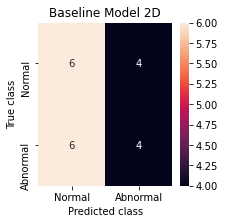

In [278]:
# predictions
base_model_pred_y = base_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
base_pred_bool = (base_model_pred_y >= 0.5)

base_model_pred_y2 = np.array(base_pred_bool, dtype=int)

print(classification_report(y_test, base_model_pred_y2,
                            target_names=target_names))

from sklearn.metrics import confusion_matrix, precision_recall_curve
import seaborn as sns
import matplotlib.pyplot as plt

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=base_model_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Baseline Model 2D")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [280]:
# Train with Batch Norm Job

role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

learning_rate = 0.0001
batch_size = 1
epochs = 50

BatchNorm_estimator = TensorFlow(entry_point='model_2D_batchnorm.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='2D-batchnorm')



In [281]:
BatchNorm_estimator.fit({'training': s3_train_data, 'validation': s3_val_data})

2021-06-15 18:02:10 Starting - Starting the training job...
2021-06-15 18:02:12 Starting - Launching requested ML instancesProfilerReport-1623780130: InProgress
......
2021-06-15 18:03:38 Starting - Preparing the instances for training.........
2021-06-15 18:05:10 Downloading - Downloading input data
2021-06-15 18:05:10 Training - Downloading the training image............
2021-06-15 18:06:58 Training - Training image download completed. Training in progress.2021-06-15 18:07:02,269 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-15 18:07:02,845 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hy

In [ ]:
#2021-06-15 18:09:27,455 sagemaker-containers INFO     Reporting training SUCCESS

#2021-06-15 18:09:39 Uploading - Uploading generated training model
#2021-06-15 18:09:39 Completed - Training job completed
#Training seconds: 291
#Billable seconds: 291
#Model: "ALight3DCNN_BatchNorm"
#_________________________________________________________________
#Layer (type)                 Output Shape              Param #   
#=================================================================
#input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
#_________________________________________________________________
#conv2d (Conv2D)              (None, 222, 222, 64)      1792      
#_________________________________________________________________
#max_pooling2d (MaxPooling2D) (None, 111, 111, 64)      0         
#_________________________________________________________________
#batch_normalization (BatchNo (None, 111, 111, 64)      256       
#_________________________________________________________________
#conv2d_1 (Conv2D)            (None, 109, 109, 64)      36928     
#_________________________________________________________________
#max_pooling2d_1 (MaxPooling2 (None, 54, 54, 64)        0         
#_________________________________________________________________
#batch_normalization_1 (Batch (None, 54, 54, 64)        256       
#_________________________________________________________________
#conv2d_2 (Conv2D)            (None, 52, 52, 128)       73856     
#_________________________________________________________________
#max_pooling2d_2 (MaxPooling2 (None, 26, 26, 128)       0         
#_________________________________________________________________
#batch_normalization_2 (Batch (None, 26, 26, 128)       512       
#_________________________________________________________________
#conv2d_3 (Conv2D)            (None, 24, 24, 256)       295168    
#_________________________________________________________________
#max_pooling2d_3 (MaxPooling2 (None, 12, 12, 256)       0         
#_________________________________________________________________
#batch_normalization_3 (Batch (None, 12, 12, 256)       1024      
#_________________________________________________________________
#global_average_pooling2d (Gl (None, 256)               0         
#_________________________________________________________________
#dense (Dense)                (None, 512)               131584    
#_________________________________________________________________
#dropout (Dropout)            (None, 512)               0         
#_________________________________________________________________
#dense_1 (Dense)              (None, 1)                 513       
#=================================================================
#Total params: 541,889
#Trainable params: 540,865
#Non-trainable params: 1,024
#- loss: 0.6935 - accuracy: 0.4643 - precision: 0.4950 - f1_score: 0.5096 - recall: 0.5251 - auc: 0.4857 
#- val_loss: 0.6862 - val_accuracy: 0.5000 - val_precision: 0.4946 - val_f1_score: 0.5078 
#                          - val_recall: 0.5218 - val_auc: 0.6488
                          
#Validation Loss    : 0.6862406373023987
#Validation Accuracy: 0.5
#Validation F1 Score: 0.49466556
#Validation Precision: 0.50734556
#Validation Recall: 0.5206931
#Validation AUC: 0.64875

In [283]:
batchnorm_name = BatchNorm_estimator.latest_training_job.name
batchnorm_name

'2D-batchnorm-2021-06-15-18-02-10-239'

In [289]:
batchnorm_name = BatchNorm_estimator.latest_training_job.name

# Save best model
from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

batchnorm_tf_model = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/2D-batchnorm-2021-06-15-18-02-10-239/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
batchnorm_deploy = batchnorm_tf_model.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
batchnorm_ep = batchnorm_deploy.endpoint


update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


------------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
              precision    recall  f1-score   support

      Normal       0.50      0.70      0.58        10
    Abnormal       0.50      0.30      0.37        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.48        20
weighted avg       0.50      0.50      0.48        20



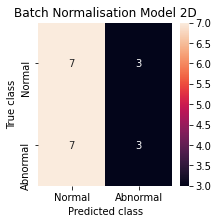

In [291]:
# Load Baseline Model
batchnorm_model = tf.keras.models.load_model(os.path.join('ALight_2D_CNN_BatchNorm.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})

# BatchNorm Model predictions
batchnorm_pred_y = batchnorm_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
batchnorm_pred_bool = (batchnorm_pred_y >= 0.5)

batchnorm_pred_y2 = np.array(batchnorm_pred_bool, dtype=int)

print(classification_report(y_test, batchnorm_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=batchnorm_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Batch Normalisation Model 2D")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [293]:
# final 2D model
model_final_estimator = TensorFlow(entry_point='model_2D_final.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='2D-Final')

model_final_estimator.fit({'training': s3_train_data, 'validation': s3_val_data})

2021-06-15 18:48:33 Starting - Starting the training job...
2021-06-15 18:48:56 Starting - Launching requested ML instancesProfilerReport-1623782913: InProgress
......
2021-06-15 18:49:59 Starting - Preparing the instances for training.........
2021-06-15 18:51:25 Downloading - Downloading input data...
2021-06-15 18:51:57 Training - Downloading the training image.........
2021-06-15 18:53:22 Training - Training image download completed. Training in progress.2021-06-15 18:53:26,710 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-15 18:53:27,221 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hy

In [ ]:
#2021-06-15 18:55:52,970 sagemaker-containers INFO     Reporting training SUCCESS

#2021-06-15 18:56:04 Uploading - Uploading generated training model
#2021-06-15 18:56:04 Completed - Training job completed
#Training seconds: 279
#Billable seconds: 279

#Model: "ALight3DCNN_FINAL"
#_________________________________________________________________
#Layer (type)                 Output Shape              Param #   
#=================================================================
#input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
#_________________________________________________________________
#conv2d (Conv2D)              (None, 222, 222, 64)      1792      
#_________________________________________________________________
#max_pooling2d (MaxPooling2D) (None, 111, 111, 64)      0         
#_________________________________________________________________
#batch_normalization (BatchNo (None, 111, 111, 64)      256       
#_________________________________________________________________
#conv2d_1 (Conv2D)            (None, 109, 109, 64)      36928     
#_________________________________________________________________
#max_pooling2d_1 (MaxPooling2 (None, 54, 54, 64)        0         
#_________________________________________________________________
#batch_normalization_1 (Batch (None, 54, 54, 64)        256       
#_________________________________________________________________
#conv2d_2 (Conv2D)            (None, 52, 52, 128)       73856     
#_________________________________________________________________
#max_pooling2d_2 (MaxPooling2 (None, 26, 26, 128)       0         
#_________________________________________________________________
#batch_normalization_2 (Batch (None, 26, 26, 128)       512       
#_________________________________________________________________
#conv2d_3 (Conv2D)            (None, 24, 24, 256)       295168    
#_________________________________________________________________
#max_pooling2d_3 (MaxPooling2 (None, 12, 12, 256)       0         
#_________________________________________________________________
#batch_normalization_3 (Batch (None, 12, 12, 256)       1024      
#_________________________________________________________________
#conv2d_4 (Conv2D)            (None, 10, 10, 256)       590080    
#_________________________________________________________________
#max_pooling2d_4 (MaxPooling2 (None, 5, 5, 256)         0         
#_________________________________________________________________
#batch_normalization_4 (Batch (None, 5, 5, 256)         1024      
#_________________________________________________________________
#conv2d_5 (Conv2D)            (None, 3, 3, 128)         295040    
#_________________________________________________________________
#max_pooling2d_5 (MaxPooling2 (None, 1, 1, 128)         0         
#_________________________________________________________________
#batch_normalization_5 (Batch (None, 1, 1, 128)         512       
#_________________________________________________________________
#global_average_pooling2d (Gl (None, 128)               0         
#_________________________________________________________________
#dense (Dense)                (None, 512)               66048     
#_________________________________________________________________
#dropout (Dropout)            (None, 512)               0         
#_________________________________________________________________
#flatten (Flatten)            (None, 512)               0         
#_________________________________________________________________
#dense_1 (Dense)              (None, 128)               65664     
#_________________________________________________________________
#dense_2 (Dense)              (None, 64)                8256      
#_________________________________________________________________
#dense_3 (Dense)              (None, 32)                2080      
#_________________________________________________________________
#dense_4 (Dense)              (None, 10)                330       
#_________________________________________________________________
#dense_5 (Dense)              (None, 1)                 11        
#=================================================================
#Total params: 1,438,837
#Trainable params: 1,437,045
#Non-trainable params: 1,792
                          
#- loss: 0.6932 - accuracy: 0.4714 - precision: 0.4727 - f1_score: 0.5274 - recall: 0.5965 - auc: 0.5000 
#- val_loss: 0.6931 - val_accuracy: 0.5000 - val_precision: 0.4730 - val_f1_score: 0.5280 - val_recall: 0.5973 
#- val_auc: 0.5000

#Validation Loss    : 0.6931471824645996
#Validation Accuracy: 0.5
#Validation F1 Score: 0.47287482
#Validation Precision: 0.5286363
#Validation Recall: 0.59930694
#Validation AUC: 0.5

In [297]:
model_final_name = model_final_estimator.latest_training_job.name
model_final_name

'2D-Final-2021-06-15-18-48-33-140'

In [298]:
model_final_tf_model = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/2D-Final-2021-06-15-18-48-33-140/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
model_final_deploy = model_final_tf_model.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
model_final_ep = model_final_deploy.endpoint


update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-------------!

The endpoint attribute has been renamed in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


/home/ec2-user/anaconda3/envs/tensorflow2_p36/lib/python3.6/site-packages/ipykernel/__main__.py:10: RuntimeWarning: invalid value encountered in greater_equal
/home/ec2-user/anaconda3/envs/tensorflow2_p36/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/envs/tensorflow2_p36/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/ec2-user/anaconda3/envs/tensorflow2_p36/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1245: UndefinedMetricWarning: Precision 

              precision    recall  f1-score   support

      Normal       0.50      1.00      0.67        10
    Abnormal       0.00      0.00      0.00        10

    accuracy                           0.50        20
   macro avg       0.25      0.50      0.33        20
weighted avg       0.25      0.50      0.33        20



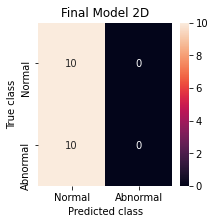

In [301]:
# Final Model Predictions
final_model = tf.keras.models.load_model(os.path.join('ALight_2D_CNN_FINAL.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})

# BatchNorm Model predictions
final_model_pred_y = final_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
final_model_pred_bool = (final_model_pred_y >= 0.5)

final_model_pred_y2 = np.array(final_model_pred_bool, dtype=int)

print(classification_report(y_test, final_model_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=final_model_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Final Model 2D")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [314]:
pip install nibabel

OSError: [Errno 12] Cannot allocate memory

In [ ]:
#sagemaker-us-east-2-584548989228/A3_ALight3DCNN/3D_CT/CT-0/
#sagemaker-us-east-2-584548989228/A3_ALight3DCNN/3D_CT/CT-23/


In [ ]:
# download and preprocess 3D CT data
import nibabel as nib
from scipy import ndimage

def read_nifti_file(filepath):
    """Read and load volume"""
    # Read file
    scan = nib.load(filepath)
    # Get raw data
    scan = scan.get_fdata()
    return scan

def normalize(volume):
    """Normalize the volume"""
    min = -1000
    max = 400
    volume[volume < min] = min
    volume[volume > max] = max
    volume = (volume - min) / (max - min)
    volume = volume.astype("float32")
    return volume

def resize_volume(img):
    """Resize across z-axis"""
    # Set the desired depth
    desired_depth = 64
    desired_width = 224
    desired_height = 224
    # Get current depth
    current_depth = img.shape[-1]
    current_width = img.shape[0]
    current_height = img.shape[1]
    # Compute depth factor
    depth = current_depth / desired_depth
    width = current_width / desired_width
    height = current_height / desired_height
    depth_factor = 1 / depth
    width_factor = 1 / width
    height_factor = 1 / height
    # Rotate
    img = ndimage.rotate(img, 90, reshape=False)
    # Resize across z-axis
    img = ndimage.zoom(img, (width_factor, height_factor, depth_factor), order=1)
    return img

def process_scan(path):
    """Read and resize volume"""
    # Read scan
    volume = read_nifti_file(path)
    # Normalize
    volume = normalize(volume)
    # Resize width, height and depth
    volume = resize_volume(volume)
    return volume


In [305]:
#CT_2D/S3_2DCT/training.npz
s3_3D_train = 's3://sagemaker-us-east-2-584548989228//S3_3DCT/training.npz'
s3_3D_val = 's3://sagemaker-us-east-2-584548989228//S3_3DCT/val.npz'


In [311]:
# 3D Models
estm_3D = TensorFlow(entry_point='model_2D_baseline_3D.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-Baseline')

estm_3D.fit({'training': s3_3D_train, 'validation': s3_3D_val})

2021-06-15 19:51:20 Starting - Starting the training job...
2021-06-15 19:51:43 Starting - Launching requested ML instancesProfilerReport-1623786680: InProgress
......
2021-06-15 19:52:43 Starting - Preparing the instances for training......
2021-06-15 19:53:43 Downloading - Downloading input data...
2021-06-15 19:54:19 Training - Downloading the training image.........
2021-06-15 19:55:44 Training - Training image download completed. Training in progress.2021-06-15 19:55:44,883 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-15 19:55:45,385 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hyper

UnexpectedStatusException: Error for Training job 3D-Baseline-2021-06-15-19-51-20-213: Failed. Reason: AlgorithmError: ExecuteUserScriptError:
Command "/usr/bin/python3 model_2D_baseline_3D.py --model_dir s3://sagemaker-us-east-2-584548989228/3D-Baseline-2021-06-15-19-51-20-213/model"

In [ ]:
3D_baseline_model = 3D_estimator.latest_training_job.name

3D_estimator_tf = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/.../output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
3D_estimator_deploy = 3D_estimator_tf.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
3D_estimator_ep = 3D_estimator_deploy.endpoint


In [ ]:
# Final Model Predictions
3D_model = tf.keras.models.load_model(os.path.join('ALight_3D_CNN_baseline.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})

# BatchNorm Model predictions
3D_baseline_pred_y = 3D_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
3D_baseline_pred_bool = (3D_baseline_pred_y >= 0.5)

3D_baseline_pred_y2 = np.array(3D_baseline_bool, dtype=int)

print(classification_report(y_test, 3D_baseline_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=3D_baseline_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("3D Baseline Model")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [ ]:
# 3D Models
3D_batchnorm = TensorFlow(entry_point='model_3D_batchnorm.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-batchnorm')

3D_batchnorm_estimator.fit({'training': s3_3D_train, 'validation': s3_3D_val})

In [ ]:
3D_baseline_model = 3D_estimator.latest_training_job.name

3D_estimator_tf = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/.../output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
3D_estimator_deploy = 3D_estimator_tf.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
3D_estimator_ep = 3D_estimator_deploy.endpoint


In [ ]:
# Final Model Predictions
3D_model = tf.keras.models.load_model(os.path.join('ALight_3D_CNN_baseline.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})

# BatchNorm Model predictions
3D_baseline_pred_y = 3D_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
3D_baseline_pred_bool = (3D_baseline_pred_y >= 0.5)

3D_baseline_pred_y2 = np.array(3D_baseline_bool, dtype=int)

print(classification_report(y_test, 3D_baseline_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=3D_baseline_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("3D Baseline Model")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [ ]:
# 3D Models
3D_batchnorm = TensorFlow(entry_point='model_3D_batchnorm.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='3D-batchnorm')

3D_batchnorm_estimator.fit({'training': s3_3D_train, 'validation': s3_3D_val})

In [ ]:
3D_baseline_model = 3D_estimator.latest_training_job.name

3D_estimator_tf = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/.../output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

# Deploy Baseline Model
3D_estimator_deploy = 3D_estimator_tf.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')

# Baseline Model Endpoint
3D_estimator_ep = 3D_estimator_deploy.endpoint


In [ ]:
# 3D Final Model Predictions
3D_final_model = tf.keras.models.load_model(os.path.join('ALight_3D_CNN_baseline.h5'),
                                       custom_objects = {'binary_precision':km.binary_precision(),
                                                        'binary_recall':km.binary_recall(),
                                                        'binary_f1_score':km.f1_score()})

# BatchNorm Model predictions
3D_baseline_pred_y = 3D_model.predict(x_test)
target_names = ["Normal", "Abnormal"]
3D_baseline_pred_bool = (3D_baseline_pred_y >= 0.5)

3D_baseline_pred_y2 = np.array(3D_baseline_bool, dtype=int)

print(classification_report(y_test, 3D_baseline_pred_y2,
                            target_names=target_names))

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=3D_baseline_pred_y2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("3D Baseline Model")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

In [ ]:
#HPO job

In [ ]:
# Define parameter ranges :
from time import gmtime, strftime
from sagemaker.tuner import (IntegerParameter,
                             ContinuousParameter,
                            CategoricalParameter,
                            HyperparameterTuner)

hyperparameter_ranges = { 
    'activation_function': CategoricalParameter(["ReLU","SGD"])
    'epochs' :       IntegerParameter(10, 15, 20, 50), 
    'learning-rate': ContinuousParameter(0.0001, 0.1, 
                                         scaling_type='ReverseLogarithmic'), 
    'batch-size':    IntegerParameter([2, 4, 8, 16]),
    'dense-layer':   IntegerParameter(16, 64, 265, 530),
    # L1 regularisation
    'l1':            ContinuousParameter(0.005, 0.01, 
                                         scaling_type='Logarithmic'),
    #The weight decay parameter (L2 regularization) 
    'wd':            ContinuousParameter(0.005, 0.01, 
                                         scaling_type='Logarithmic')
    
}

objective_metric_name = 'validation_accuracy' 
objective_type = 'Maximize' 

metric_definitions = [
    {'Name': 'training_loss',        'Regex': 'loss:         ([0-9\\.]+)'},
    {'Name': 'training_accuracy',    'Regex': 'accuracy:     ([0-9\\.]+)'},
    {'Name': 'validation_loss',      'Regex': 'val_loss:     ([0-9\\.]+)'},
    {'Name': 'validation_accuracy',  'Regex': 'val_accuracy: ([0-9\\.]+)'},
    
    {'Name': 'training_precision',   'Regex': 'precision:    ([0-9\\.]+)'},
    {'Name': 'training_recall',      'Regex': 'recall:       ([0-9\\.]+)'},
    {'Name': 'training_auc',         'Regex': 'auc:          ([0-9\\.]+)'},
    {'Name': 'training_F1',          'Regex': 'F1:           ([0-9\\.]+)'},

    {'Name': 'validation_precision',   'Regex': 'precision:    ([0-9\\.]+)'},
    {'Name': 'validation_recall',      'Regex': 'recall:       ([0-9\\.]+)'},
    {'Name': 'validation_auc',         'Regex': 'auc:          ([0-9\\.]+)'},
    {'Name': 'validation_F1',          'Regex': 'F1:           ([0-9\\.]+)'},
    ] 

In [ ]:
# Apply and fit HPO tuner to the tensorflow training job
from sagemaker.tuner import HyperparameterTuner

HPOtuner = HyperparameterTuner(my_estimator,
                            objective_metric_name, 
                            hyperparameter_ranges, 
                            metric_definitions, 
                            max_jobs=5,
                            max_parallel_jobs=1, 
                            objective_type=objective_type)

In [ ]:
# Inspect the HPO tuned networks and save the best model
from sagemaker.analytics import HyperparameterTuningJobAnalytics

exp = HyperparameterTuningJobAnalytics(
    sagemaker_session=sess,  
    hyperparameter_tuning_job_name=tuner.latest_tuning_job.name)

df = exp.dataframe()
df

In [ ]:
# Select the best job by highest accuracy
best_job = df.sort_values('FinalObjectiveValue', ascending=0)[:1] # FinalObjectiveValue = Accuracy
best_job

In [ ]:
# Pull out the name of the best job
best_job_name = best_job['TrainingJobName'].to_string(index=False).strip()
best_job_name

In [ ]:
# Finding where the best model is stored 
import boto3 
sm = boto3.client('sagemaker') # where the model is being stored in s3

In [ ]:
# Save best model
best_job = sm.describe_training_job(TrainingJobName=best_job_name)

best_model_artefact = best_job['ModelArtifacts']['S3ModelArtifacts']
best_model_container = best_job['AlgorithmSpecification']['TrainingImage']

print(best_job_name)
print(best_model_artefact)
print(best_model_container)

In [ ]:
job_name = my_estimator.latest_training_job.name
job_name
#ReAdmNet1-2021-05-28-13-07-07-367/

### Transfer Learning from ResNet50

In [49]:
import keras_metrics

In [50]:
# Building Model
resnet = ResNet50(weights="imagenet", include_top=False,
    input_tensor=Input(shape=(224, 224, 3)))

outputs = resnet.output
outputs = Flatten(name="flatten")(outputs)
outputs = Dropout(0.5)(outputs)
outputs = Dense(1, activation="sigmoid")(outputs)

model = Model(inputs=resnet.input, outputs=outputs)

for layer in resnet.layers:
    layer.trainable = False

model.compile(
        loss='binary_crossentropy', 
        optimizer='adam', 
        metrics=['accuracy',
                 keras_metrics.f1_score(),
                 keras_metrics.precision(),
                 keras_metrics.recall(),
                 tf.keras.metrics.AUC()]
)

94773248/94765736 [==============================] - 1s 0us/step
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> tp
tracking <tf.Variable 'Variable:0' shape=() dtype=int32, numpy=0> fn


In [51]:
# Visualize Model
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [31]:
# train augmentation
train_aug = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True
)


In [96]:
tf_train = tf.data.Dataset.from_tensor_slices((x_train, y_train))
tf_val = tf.data.Dataset.from_tensor_slices((x_val, y_val))


In [97]:
print(x_train.shape)
print(y_train.shape)
print(tf_train)

(40, 224, 224, 3)
(40,)
<TensorSliceDataset shapes: ((224, 224, 3), ()), types: (tf.float64, tf.int64)>


In [78]:
epochs = 50
batch_size = 5

# train Resnet
history = model.fit(train_aug.flow(x_train, y_train, 
                                   batch_size=batch_size),
                    validation_data=(x_val, y_val),
                    validation_steps=len(x_val) / batch_size,
                    steps_per_epoch=len(x_train) / batch_size,
                    epochs=50)


  ...
    to  
  ['...']
Train for 28.0 steps, validate on 40 samples
Epoch 1/50
28/28 [==============================] - 18s 631ms/step - loss: 1.3911 - accuracy: 0.4571 - f1_score: 0.5127 - precision: 0.5128 - recall: 0.5127 - auc_1: 0.4660 - val_loss: 0.9822 - val_accuracy: 0.5000 - val_f1_score: 0.5261 - val_precision: 0.5220 - val_recall: 0.5304 - val_auc_1: 0.4850
Epoch 2/50
28/28 [==============================] - 15s 525ms/step - loss: 1.4320 - accuracy: 0.5286 - f1_score: 0.5208 - precision: 0.5072 - recall: 0.5351 - auc_1: 0.5367 - val_loss: 1.3088 - val_accuracy: 0.5000 - val_f1_score: 0.5091 - val_precision: 0.5099 - val_recall: 0.5084 - val_auc_1: 0.4637
Epoch 3/50
28/28 [==============================] - 15s 525ms/step - loss: 1.4182 - accuracy: 0.5143 - f1_score: 0.5086 - precision: 0.5086 - recall: 0.5085 - auc_1: 0.5018 - val_loss: 0.8912 - val_accuracy: 0.5250 - val_f1_score: 0.5237 - val_precision: 0.5195 - val_recall: 0.5280 - val_auc_1: 0.4475
Epoch 4/50
28/28 [===

In [79]:
# Save Model and Weights
model.save('resnet_ct.h5')
model.save_weights('resnet_weights_ct.hdf5')

In [ ]:
# Load saved model
model = load_model('resnet_ct.h5')

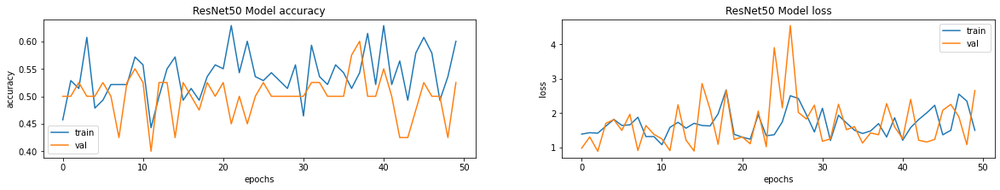

In [85]:
fig, ax = plt.subplots(1, 2, figsize=(20, 3))
ax = ax.ravel()

for i, metric in enumerate(["accuracy", "loss"]):
    ax[i].plot(model.history.history[metric])
    ax[i].plot(model.history.history["val_" + metric])
    ax[i].set_title("ResNet50 Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])


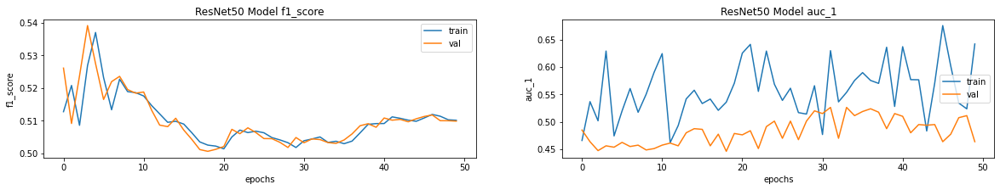

In [86]:
fig, ax = plt.subplots(1, 2, figsize=(20, 3))
ax = ax.ravel()

for i, metric in enumerate(["f1_score", "auc_1"]):
    ax[i].plot(model.history.history[metric])
    ax[i].plot(model.history.history["val_" + metric])
    ax[i].set_title("ResNet50 Model {}".format(metric))
    ax[i].set_xlabel("epochs")
    ax[i].set_ylabel(metric)
    ax[i].legend(["train", "val"])

In [89]:
# predictions
y_pred = model.predict(x_test, batch_size=batch_size)

target_names = ["Normal", "Abnormal"]
pred_bool = (y_pred >= 0.5)

y_pred2 = np.array(pred_bool, dtype=int)

print(classification_report(y_test, y_pred2,
                            target_names=target_names))
RESNET50 PERFORMANCE

              precision    recall  f1-score   support

      Normal       0.50      0.90      0.64        10
    Abnormal       0.50      0.10      0.17        10

    accuracy                           0.50        20
   macro avg       0.50      0.50      0.40        20
weighted avg       0.50      0.50      0.40        20



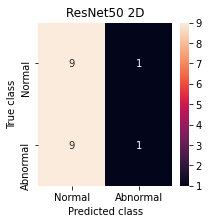

In [90]:

from sklearn.metrics import confusion_matrix, precision_recall_curve
import seaborn as sns
import matplotlib.pyplot as plt

LABELS = ["Normal","Abnormal"]
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred2)
tn, fp, fn, tp = conf_matrix.ravel() 
plt.figure(figsize=(3, 3))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("ResNet50 2D")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()

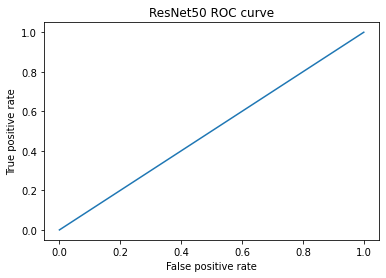

In [91]:
# ResNet50 ROC-AUC Curve
plt.figure(1)
plt.plot([0, 1], [0, 1])

for ii in range(1, y_pred2.shape[1]):
    fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test[:,ii], y_pred2[:,ii])
    auc_keras = auc(fpr_keras, tpr_keras)
    plt.plot(fpr_keras, tpr_keras, 
             label=Labels + '(area = {:.3f})'.format(auc_keras))
    
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ResNet50 ROC curve')
plt.show()

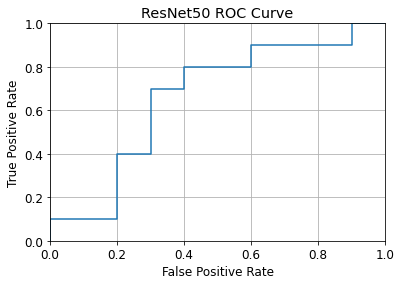

In [93]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred)
plt.plot(fpr, tpr)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.rcParams['font.size'] = 12
plt.title('ResNet50 ROC Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.grid(True)


## 6. 3D CNN Base Model 

In [25]:
role = sagemaker.get_execution_role()
from sagemaker.tensorflow import TensorFlow

my_estimator = TensorFlow(entry_point='train_ALightCNN_3D_2.py',
                          role=role,
                          instance_count=1,
                          instance_type='ml.p2.xlarge',
                          #instance_type='ml.m4.xlarge',
                          framework_version='2.1.0',
                          py_version='py3',
                          script_mode=True,
                          base_job_name='ALight-3D-CNN-best')

In [26]:
my_estimator.fit({'training': s3_train_data, 'validation': s3_validation_data})


2021-06-13 14:09:49 Starting - Starting the training job...
2021-06-13 14:09:51 Starting - Launching requested ML instancesProfilerReport-1623593389: InProgress
......
2021-06-13 14:11:03 Starting - Preparing the instances for training.........
2021-06-13 14:12:44 Downloading - Downloading input data...
2021-06-13 14:13:04 Training - Downloading the training image........2021-06-13 14:14:29,685 sagemaker-containers INFO     Imported framework sagemaker_tensorflow_container.training
2021-06-13 14:14:30,227 sagemaker-containers INFO     Invoking user script

Training Env:

{
    "additional_framework_parameters": {},
    "channel_input_dirs": {
        "training": "/opt/ml/input/data/training",
        "validation": "/opt/ml/input/data/validation"
    },
    "current_host": "algo-1",
    "framework_module": "sagemaker_tensorflow_container.training:main",
    "hosts": [
        "algo-1"
    ],
    "hyperparameters": {
        "model_dir": "s3://sagemaker-us-east-2-584548989228/ALight-3D-C

### 6.3 Hyperparameter Tuning

In [12]:
# Define parameter ranges :
from time import gmtime, strftime
from sagemaker.tuner import (IntegerParameter,
                             ContinuousParameter,
                            CategoricalParameter,
                            HyperparameterTuner)

hyperparameter_ranges = { 
    'activation_function': CategoricalParameter(["ReLU","SGD"]),
    'epochs' :       IntegerParameter(1, 50), 
    'learning-rate': ContinuousParameter(0.00001, 0.1, 
                                         scaling_type='ReverseLogarithmic'), 
    'batch-size':    CategoricalParameter([1, 2, 4, 8]),
    'dense-layer':   IntegerParameter(16, 530),
    # L1 regularisation
    'l1':            ContinuousParameter(0.005, 1, 
                                         scaling_type='Logarithmic'),
    #The weight decay parameter (L2 regularization) 
    'wd':            ContinuousParameter(0.005, 1, 
                                         scaling_type='Logarithmic')
    
}

objective_metric_name = 'validation_accuracy' 
objective_type = 'Maximize' 

metric_definitions = [
    {'Name': 'training_loss',        'Regex': 'loss:         ([0-9\\.]+)'},
    {'Name': 'training_accuracy',    'Regex': 'accuracy:     ([0-9\\.]+)'},
    {'Name': 'validation_loss',      'Regex': 'val_loss:     ([0-9\\.]+)'},
    {'Name': 'validation_accuracy',  'Regex': 'val_accuracy: ([0-9\\.]+)'},
    
    {'Name': 'training_precision',   'Regex': 'precision:    ([0-9\\.]+)'},
    {'Name': 'training_recall',      'Regex': 'recall:       ([0-9\\.]+)'},
    {'Name': 'training_auc',         'Regex': 'auc:          ([0-9\\.]+)'},
    {'Name': 'training_F1',          'Regex': 'F1:           ([0-9\\.]+)'},

    {'Name': 'validation_precision',   'Regex': 'precision:    ([0-9\\.]+)'},
    {'Name': 'validation_recall',      'Regex': 'recall:       ([0-9\\.]+)'},
    {'Name': 'validation_auc',         'Regex': 'auc:          ([0-9\\.]+)'},
    {'Name': 'validation_F1',          'Regex': 'F1:           ([0-9\\.]+)'},
    ] 

In [13]:
# Apply and fit HPO tuner to the tensorflow training job
from sagemaker.tuner import HyperparameterTuner

HPOtuner = HyperparameterTuner(my_estimator,
                            objective_metric_name, 
                            hyperparameter_ranges, 
                            metric_definitions, 
                            max_jobs=4,
                            max_parallel_jobs=1, 
                            objective_type=objective_type)

In [50]:
s3_train_data

's3://sagemaker-us-east-2-584548989228/S3_3D_CT_Data/3D_CT/training/training.npz'

In [20]:
#fit is used to train the model
HPOtuner.fit({'training': s3_train_data, 'validation': s3_validation_data})

HPOtuner.wait()


...............................................................................................................................................................................................................................................................................................................................................!


NameError: name 'tuner' is not defined

In [22]:
# Inspect the HPO tuned networks and save the best model
from sagemaker.analytics import HyperparameterTuningJobAnalytics

exp = HyperparameterTuningJobAnalytics(
    sagemaker_session=sess,  
    hyperparameter_tuning_job_name=HPOtuner.latest_tuning_job.name)

df = exp.dataframe()
df

,activation_function,batch-size,dense-layer,epochs,l1,learning-rate,wd,TrainingJobName,TrainingJobStatus,FinalObjectiveValue,TrainingStartTime,TrainingEndTime,TrainingElapsedTimeSeconds
0,"""ReLU""","""4""",456.0,8.0,0.006467,0.057290,0.007333,tensorflow-training-210612-1815-004-52e17051,Completed,0.500,2021-06-12 18:39:36+00:00,2021-06-12 18:42:54+00:00,198.0
1,"""ReLU""","""4""",398.0,19.0,0.008337,0.034455,0.006649,tensorflow-training-210612-1815-003-25a17873,Completed,0.500,2021-06-12 18:32:12+00:00,2021-06-12 18:35:42+00:00,210.0
2,"""ReLU""","""4""",58.0,3.0,0.010000,0.041626,0.006500,tensorflow-training-210612-1815-002-3f3e806c,Completed,0.500,2021-06-12 18:24:37+00:00,2021-06-12 18:28:21+00:00,224.0
3,"""SGD""","""2""",520.0,9.0,0.009656,0.082250,0.007717,tensorflow-training-210612-1815-001-43d1525a,Completed,0.475,2021-06-12 18:18:07+00:00,2021-06-12 18:21:46+00:00,219.0


In [23]:
# Select the best job by highest accuracy
best_job = df.sort_values('FinalObjectiveValue', ascending=0)[:1] # FinalObjectiveValue = Accuracy
best_job

,activation_function,batch-size,dense-layer,epochs,l1,learning-rate,wd,TrainingJobName,TrainingJobStatus,FinalObjectiveValue,TrainingStartTime,TrainingEndTime,TrainingElapsedTimeSeconds
0,"""ReLU""","""4""",456.0,8.0,0.006467,0.05729,0.007333,tensorflow-training-210612-1815-004-52e17051,Completed,0.5,2021-06-12 18:39:36+00:00,2021-06-12 18:42:54+00:00,198.0


In [24]:
# Pull out the name of the best job
best_job_name = best_job['TrainingJobName'].to_string(index=False).strip()
best_job_name

'tensorflow-training-210612-1815-004-52e17051'

In [5]:
# Finding where the best model is stored 
import boto3 
sm = boto3.client('sagemaker') # where the model is being stored in s3

In [3]:
best_job_name = 'tensorflow-training-210612-1815-004-52e17051'

# Load Baseline Model if Endpoint Was Deleted
#job_load = my_estimator.latest_training_job.name
#job_load
#endpoint_name=predictor.endpoint

In [15]:
# Save best model
best_job = sm.describe_training_job(TrainingJobName=best_job_name)

best_model_artefact = best_job['ModelArtifacts']['S3ModelArtifacts']
best_model_container = best_job['AlgorithmSpecification']['TrainingImage']

print(best_job_name)
print(best_model_artefact)
print(best_model_container)

tensorflow-training-210612-1815-004-52e17051
s3://sagemaker-us-east-2-584548989228/tensorflow-training-210612-1815-004-52e17051/output/model.tar.gz
763104351884.dkr.ecr.us-east-2.amazonaws.com/tensorflow-training:2.1.0-gpu-py3


In [19]:
# Create a utility for initial deployment as well as deployment following endpoint deletion

#job_name = "ReAdmNet1-2021-05-28-13-07-07-367/"
from sagemaker.tensorflow import TensorFlowModel
role = sagemaker.get_execution_role()

model = TensorFlowModel(model_data='s3://sagemaker-us-east-2-584548989228/tensorflow-training-210612-1815-004-52e17051/output/model.tar.gz',
                        role=role,
                       framework_version='2.1.0')

predictor = model.deploy(initial_instance_count=1, 
                         instance_type='ml.m4.xlarge')


update_endpoint is a no-op in sagemaker>=2.
See: https://sagemaker.readthedocs.io/en/stable/v2.html for details.


-------------!